First we need to download the parquet file from https://satellogic-earthview.s3.us-west-2.amazonaws.com/colab/satellogic-earthview-items.parquet

Then we can read it an put it into a geopandas GeoDataFrame using the `read_parquet` function.

In [80]:
!curl -O https://satellogic-earthview.s3.us-west-2.amazonaws.com/colab/satellogic-earthview-items.parquet

^C


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0  258M    0 16944    0     0  19346      0  3:53:34 --:--:--  3:53:34 19431
  0  258M    0 1702k    0     0   942k      0  0:04:41  0:00:01  0:04:40  944k
  4  258M    4 10.9M    0     0  4087k      0  0:01:04  0:00:02  0:01:02 4093k
  8  258M    8 21.3M    0     0  5815k      0  0:00:45  0:00:03  0:00:42 5821k
 11  258M   11 29.5M    0     0  6331k      0  0:00:41  0:00:04  0:00:37 6337k
 14  258M   14 37.6M    0     0  6698k      0  0:00:39  0:00:05  0:00:34 7894k
 16  258M   16 43.7M    0     0  6625k      0  0:00:39  0:00:06  0:00:33 8697k
 19  258M   19 50.4M    0     0  6636k      0  0:00:39  0:00:07  0:00:32 8031k
 21  258M   21 55.1M    0     0  6443k      0  0:00:41  0:00:08  0:00:33 6915k
 22  258M   22 59.3M    0     0  6174k      0  0:00

In [2]:
import geopandas as gpd

gdf = gpd.read_parquet('./raw/satellogic-earthview-items.parquet')

Now we can see the columns and the number of entries in the geodataframe, as we can see we have information of about 7 million images

In [3]:
gdf.info(True)

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 7095985 entries, 0 to 7095984
Data columns (total 5 columns):
 #   Column     Dtype         
---  ------     -----         
 0   json_path  object        
 1   zone       object        
 2   region     object        
 3   date       datetime64[ns]
 4   geometry   geometry      
dtypes: datetime64[ns](1), geometry(1), object(3)
memory usage: 324.8+ MB


Now its time to download the metadata of the images, you can download from the eotdl dataset or from the bucket, currently its giving trouble with the size of this metadata collection due to the number of files and folders and its recommended to work with the bucket remotely.

To download it from the bucket its recommended to use the [s5cmd](https://github.com/peak/s5cmd) tool.

once you have downloaded the tool you can excute the following command to download the metadata (it will take some hours and the size is of around 20 GB):

In [ ]:
!s5cmd.exe --no-sign-request cp 's3://satellogic-earthview/data/json/*' ./localData

Then if we pick any item from the parquet file we will see that it has a reference to his metadata file

In [4]:
gdf.iloc[1].json_path

'data/json/zone=04N/region=603411_2346685/date=2022-09-15/20220915_010014_SN20_04N_603411_2346685_metadata.json'

We can also se the top elements of the GeoDataFrame using his `.head()` function

In [5]:
gdf.head()

,json_path,zone,region,date,geometry
0,data/json/zone=04N/region=603411_2346301/date=...,04N,603411_2346301,2022-09-15,"POLYGON ((-157.99991 21.21181, -157.99988 21.2..."
1,data/json/zone=04N/region=603411_2346685/date=...,04N,603411_2346685,2022-09-15,"POLYGON ((-157.99988 21.21528, -157.99986 21.2..."
2,data/json/zone=04N/region=603411_2347069/date=...,04N,603411_2347069,2022-09-15,"POLYGON ((-157.99986 21.21875, -157.99984 21.2..."
3,data/json/zone=04N/region=603411_2347453/date=...,04N,603411_2347453,2022-09-15,"POLYGON ((-157.99984 21.22221, -157.99981 21.2..."
4,data/json/zone=04N/region=603411_2347837/date=...,04N,603411_2347837,2022-09-15,"POLYGON ((-157.99981 21.22568, -157.99979 21.2..."


The images dates are between July 1 of 2022, and December 30 of 2022

And here we have a approximated geolocalization of the images in a map, the representation takes only 1 every 50 images localization to optimize but this can cause to loose some of the points where we have an image from

In [19]:
import folium
from folium.plugins import MarkerCluster
index = 400
# we will only visualize the first one
geometry = []
for i in range(0,gdf.__len__(), 50):
    centroid = gdf.iloc[i].geometry.centroid
    geometry.append([centroid.y, centroid.x])
# map center and zoom
cluster = MarkerCluster(geometry)
m = folium.Map(location=[centroid.y, centroid.x], zoom_start=13)
# adding the geomtry of the item to the map
cluster.add_to(m)
folium.GeoJson(gdf.iloc[index]['geometry']).add_to(m)
# display 
m

Now we are going to work with a little subset of the metadata,

first we can just unzip the desired Zone to work with, as an example we are going to take a look at the Zone 60S

After that we can start to work with all the metadata.

In [159]:
import os

path = os.getcwd()
path += "/raw/zone=33S"


Example function to filter by sensor, in this case Satellogic, Sentinel 1 or Sentinel 2:

First we are going to get from the metadata the links to the images and the provider of the images

In [160]:
import os
import json
from dataclasses import make_dataclass
import pandas as pd

Image = make_dataclass("Image",[("provider", str), ("analytic_link", str), ("visual_link", str)]) 
images_list = []


dirs = os.listdir(path)
for dir in dirs:
    full_path = os.getcwd()
    full_path += "/raw/zone=33S"
    full_path+= "/" + dir
    for f in os.listdir(full_path):
        for metadata_file in os.listdir(full_path+"/"+f):
            with open(full_path+"/"+f+"/"+metadata_file, "r")  as file:
                json_file = json.load(file)
                provider = json_file["properties"]["providers"][0]["name"]
                analytic_image = json_file["assets"]["analytic"]["href"]
                visual_image = json_file["assets"]["visual"]["href"]
                images_list.append(Image(provider, analytic_image, visual_image)) 

images_df = pd.DataFrame(images_list)

Now we can just get one of these images and put it in a map


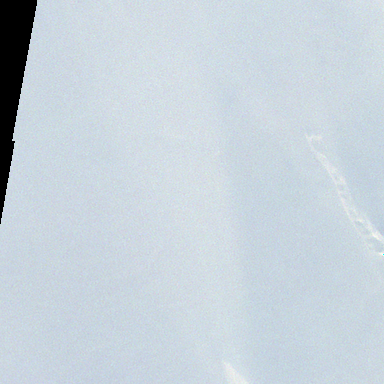

In [164]:
import folium
import rasterio as rio
from folium import raster_layers
import pyproj
from rasterio.warp import transform

path = images_df.iloc[90].visual_link

# Open the GeoTIFF with rasterio
with rio.open(path) as src:

    min_lon, min_lat, max_lon, max_lat = src.bounds
    current_crs = src.crs

    # to visualize it we need to reproject it to epsg:4326
    target_crs = pyproj.CRS('EPSG:4326')

    # transformer
    transformer = pyproj.Transformer.from_crs(current_crs, target_crs, always_xy=True)

    # transform them and get the center
    min_lon_4326, min_lat_4326 = transformer.transform(min_lon, min_lat)
    max_lon_4326, max_lat_4326 = transformer.transform(max_lon, max_lat)
    center_lat = (min_lat_4326 + max_lat_4326) / 2
    center_lon = (min_lon_4326 + max_lon_4326) / 2

    # create the map
    m = folium.Map(location=[center_lat, center_lon], zoom_start=16)

    # read the image and transpose it
    img_array = src.read().transpose(1,2,0)

    # add the raster to it
    raster_layers.ImageOverlay(
        image=img_array,
        bounds=[[min_lat_4326, min_lon_4326], [max_lat_4326, max_lon_4326]],
        opacity=1.0,
        interactive=True
    ).add_to(m)

m